In [61]:
# Librerias generales
import pandas as pd
import numpy as np
import sqlite3 as sql ### para conectarse a BD
from sklearn.impute import SimpleImputer
import plotly.express as px


# Librerias e visualización
import seaborn as sns
import matplotlib
matplotlib.use('agg')
import matplotlib.pyplot as plt
from ydata_profiling  import ProfileReport

NOTA: SE CAMBIAN TODAS LAS FECHAS DESDE EL FORMATO DE EXCEL

In [2]:
###Lectura base de asegurados expuestos
df = pd.read_csv('BD_Asegurados_Expuestos.csv', sep = ';')
df.head(10)

,Asegurado_Id,Poliza_Id,FECHA_INICIO,FECHA_CANCELACION,FECHA_FIN
0,1213170,113307876,1/09/2019,NaN,15/12/2019
1,22248110,195410143,1/09/2019,31/12/2019,31/12/2019
2,7212095,192799506,1/09/2019,31/12/2019,31/12/2019
3,23743715,145500123,1/09/2019,31/12/2019,31/12/2019
4,57822199,175415440,1/09/2019,31/12/2019,31/12/2019
5,39914668,204291309,1/12/2019,1/12/2019,1/12/2019
6,5514589,50872086,1/09/2019,NaN,31/12/2019
7,5757374,90964098,1/09/2019,NaN,31/12/2019
8,29767620,65844839,1/09/2019,NaN,31/12/2019
9,54772438,199065788,14/09/2019,NaN,31/12/2019


In [6]:
##Gráfico para observar la base de datos asegurados expuestos de una forma global
ProfileReport(df, title='Reporte de base asegurados expuestos', minimal=True, 
              progress_bar=False, interactions=None, explorative=True, dark_mode=True, 
              notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#FFCC00'}}, 
              missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

In [3]:
###Lectura base socio demograficas
df1 = pd.read_csv('BD_SocioDemograficas.csv', sep = ';')
df1.head(2)

C:\Users\dayan\AppData\Local\Temp\ipykernel_5584\4016433883.py:2: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv('BD_SocioDemograficas.csv', sep = ';')


,Afiliado_Id,Sexo_Cd,FechaNacimiento,Regional,CANCER,EPOC,DIABETES,HIPERTENSION,ENF_CARDIOVASCULAR
0,738288,2,8/11/1976,40,0,0,0,0,0
1,738294,2,16/01/1964,50,0,0,0,0,0


In [7]:
##Gráfico para observar la base socio demograficas expuestos de una forma global
ProfileReport(df1, title='Reporte de datos sociodemograficos', minimal=True, 
              progress_bar=False, interactions=None, explorative=True, dark_mode=True, 
              notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#FFCC00'}}, 
              missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

In [36]:
###Lectura base de utilizaciones medicas
df2 = pd.read_csv('BD_UtilizacionesMedicas.csv', sep = ';')
df2.head(2)

,Fecha_Reclamacion,Afiliado_Id,Reclamacion_Cd,Diagnostico_Codigo,Numero_Utilizaciones,Valor_Utilizaciones
0,28/10/2019,2668445,R10,9,1,46500
1,30/09/2019,4370072,R15,9,2,42408


In [37]:
##Gráfico para observar la base de datos utilizaciones  de una forma global
ProfileReport(df2, title='Reporte de base utilizaciones medicas', minimal=True, 
              progress_bar=False, interactions=None, explorative=True, dark_mode=True, 
              notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#FFCC00'}}, 
              missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

##BASE DE DATOS ASEGURADOS EXPUESTOS

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 231520 entries, 0 to 231519
Data columns (total 5 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   Asegurado_Id       231520 non-null  int64 
 1   Poliza_Id          231520 non-null  int64 
 2   FECHA_INICIO       231520 non-null  object
 3   FECHA_CANCELACION  104808 non-null  object
 4   FECHA_FIN          231520 non-null  object
dtypes: int64(2), object(3)
memory usage: 8.8+ MB


In [118]:
## Se transforman todas las fechas a formato fecha
df['FECHA_INICIO'] = pd.to_datetime(df['FECHA_INICIO'])
df['FECHA_CANCELACION'] = pd.to_datetime(df['FECHA_CANCELACION'])
df['FECHA_FIN'] = pd.to_datetime(df['FECHA_FIN'])

In [12]:
df.isnull().sum()

Asegurado_Id              0
Poliza_Id                 0
FECHA_INICIO              0
FECHA_CANCELACION    126712
FECHA_FIN                 0
dtype: int64

Los nulos anteriores de la fecha cancelación se dan porque el usuario aún no ha cancelado el seguro.

In [66]:
fila_igual = df[(df['FECHA_INICIO'] == df['FECHA_CANCELACION'])]

In [67]:
total=len(fila_igual)

In [68]:
##Esto sucede por un error al realizar la compra o porque compro el que no era
print('La cantidad de veces en que los usuarios ha comprado el seguro y lo ha cancelado el mismo dia es de: ', total)

La cantidad de veces en que un usuario ha comprado el seguro y lo ha cancelado el mismo dia es de:  3234


In [44]:
usuarios=df['Asegurado_Id'].nunique()

In [69]:
print('La cantidad de usuarios unicos que compran el seguro es de: ',usuarios)

La cantidad de clientes totales es de:  225763


##BASE DE DATOS SOCIODEMOGRAFICOS

In [15]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 225776 entries, 0 to 225775
Data columns (total 9 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   Afiliado_Id         225776 non-null  int64 
 1   Sexo_Cd             225776 non-null  int64 
 2   FechaNacimiento     225776 non-null  object
 3   Regional            225776 non-null  object
 4   CANCER              225776 non-null  int64 
 5   EPOC                225776 non-null  int64 
 6   DIABETES            225776 non-null  int64 
 7   HIPERTENSION        225776 non-null  int64 
 8   ENF_CARDIOVASCULAR  225776 non-null  int64 
dtypes: int64(7), object(2)
memory usage: 15.5+ MB


In [ ]:
df1['FechaNacimiento'] = pd.to_datetime(df1['FechaNacimiento'])

In [71]:
df1.isnull().sum()

Afiliado_Id           0
Sexo_Cd               0
FechaNacimiento       0
Regional              0
CANCER                0
EPOC                  0
DIABETES              0
HIPERTENSION          0
ENF_CARDIOVASCULAR    0
dtype: int64

In [81]:
df1['Sexo_Cd']=df1['Sexo_Cd'].replace({1: 'F', 2:'M',-1:'F'})

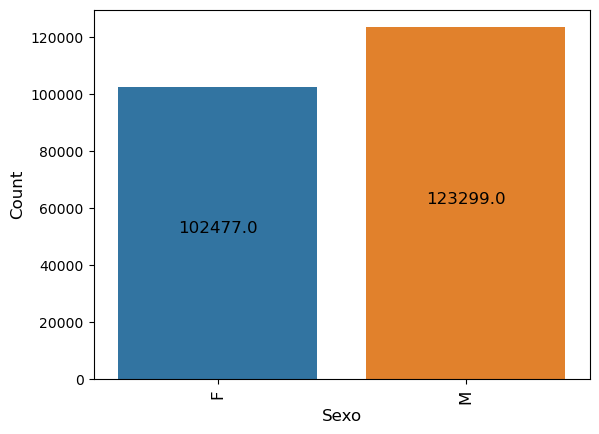

In [82]:
## Gráfico para ver la distribución sexo
ax = sns.countplot(x='Sexo_Cd',   data= df1)
plt.xlabel('Sexo', size = 12)
plt.xticks(rotation=90, size = 12)
plt.ylabel('Count', size = 12)
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()/2), ha='center', size=12)
    
plt.show()

In [96]:
casos_cancer= df1['CANCER'].sum()
casos_epoc= df1['EPOC'].sum()
casos_diabetes= df1['DIABETES'].sum()
casos_hipertension= df1['HIPERTENSION'].sum()
casos_cardiovascular= df1['ENF_CARDIOVASCULAR'].sum()


In [97]:
# Calcular el total de casos
total_casos = casos_cancer + casos_diabetes + casos_epoc + casos_hipertension + casos_cardiovascular

# Calcular los porcentajes
porcentaje_cancer = (casos_cancer / total_casos) * 100
porcentaje_diabetes = (casos_diabetes / total_casos) * 100
porcentaje_epoc = (casos_epoc / total_casos) * 100
porcentaje_hipertension = (casos_hipertension / total_casos) * 100
porcentaje_cardiovascular = (casos_cardiovascular / total_casos) * 100

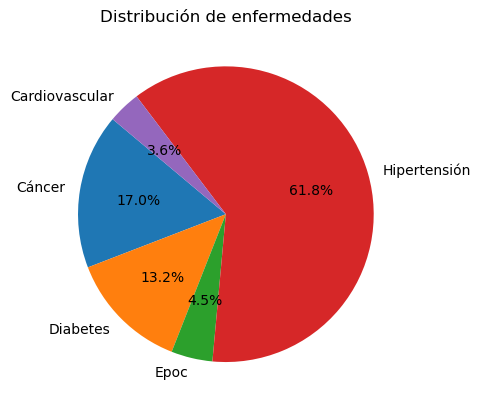

In [99]:
enfermedades = ['Cáncer', 'Diabetes', 'Epoc','Hipertensión','Cardiovascular']
porcentajes = [porcentaje_cancer, porcentaje_diabetes, porcentaje_epoc,porcentaje_hipertension,porcentaje_cardiovascular]  # Puedes ajustar estos porcentajes según tus datos

# Crear el gráfico de torta
plt.pie(porcentajes, labels=enfermedades, autopct='%1.1f%%', startangle=140)

# Añadir un título
plt.title('Distribución de enfermedades')

# Mostrar el gráfico
plt.show()

In [109]:
df1['Regional']=df1['Regional'].astype('str')

In [110]:
df1['Regional']=df1['Regional'].replace({'50': 'Occidente', '40':'Norte','30':'Eje cafetero','20':'Centro','10':'Antioquia','-1':'Sin info','#N/D':'Sin info'})

In [114]:
df1 = df1.drop(df1[df1['Regional'] == 'Sin info'].index)

In [116]:
df_reg = df1.groupby(['Regional']).agg(encounters = ('Afiliado_Id', 'count')).reset_index().sort_values(['encounters'], ascending = False)

In [117]:
#Gráfico para ver como esta distribuido la atención d elos especialistas
fig = px.treemap(df_reg, path=['Regional'], values='encounters')
fig.show()

In [160]:
##Se utiliza para sacar la edad de los usuarios
df1['EDAD']=2023 - df1['FechaNacimiento'].dt.year

In [161]:
##Se transforma la columna a entero para poder operarla
df1['EDAD']=df1['EDAD'].astype('int')

In [165]:
##Función para poder cambiar los datos de la variable edad, ya que hay unos datos que tenian unas edades atipicas por lo que se decidieron cambiar.
def agrupar_edad(edad):
    if edad>=100:
        return 99
    elif edad<=-1:
        return 0
    else:
        return edad

In [166]:
##Aplicación de la función edad
df1['EDAD']= df1['EDAD'].apply(agrupar_edad)

In [173]:
fig  = px.histogram(df1, x= 'EDAD', title= 'Histograma frecuencia de tipo de servicio por usuario')
fig.show()

En el gráfico anterior se puede observar que los usuarios que más compran seguros estan entre los 30 y 50 años, además de esto también se ve un alto volumen en los niños entre los 4 y 15 años, esto se puede deber a que cuando los padres compran el seguro de inmediato también afilian a sus hijos, es por ello que se ve un aumento en estos dos sectores, también se puede decir que los jovenes casi no compran seguros y los mayores de 80 años se ven en una baja proporción debido a que quizás hay muy poca población en esta edad o depronto también puede ser porque esto no es un negocio muy viable para los seguros, por lo tanto no se esfuerzan en vender estos seguros.

In [170]:
##Se elimina la columna fecha de nacimiento ya que vamos es a usar la Edad
df1=df1.drop('FechaNacimiento',axis=1)

##BASE DE UTILIZACIONES

In [175]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800232 entries, 0 to 800231
Data columns (total 6 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   Fecha_Reclamacion     800232 non-null  object
 1   Afiliado_Id           800232 non-null  int64 
 2   Reclamacion_Cd        800232 non-null  object
 3   Diagnostico_Codigo    800232 non-null  object
 4   Numero_Utilizaciones  800232 non-null  int64 
 5   Valor_Utilizaciones   800232 non-null  int64 
dtypes: int64(3), object(3)
memory usage: 36.6+ MB


In [174]:
df2.isnull().sum()

Fecha_Reclamacion       0
Afiliado_Id             0
Reclamacion_Cd          0
Diagnostico_Codigo      0
Numero_Utilizaciones    0
Valor_Utilizaciones     0
dtype: int64

In [ ]:
df2['Fecha_Reclamacion'] = pd.to_datetime(df2['Fecha_Reclamacion'])

In [181]:
##Agrupación para ver los 10 diagnosticos que más presentan los usuarios
df_diagnosticos = df2.groupby(['Diagnostico_Codigo']).agg(encounters = ('Afiliado_Id', 'count')).reset_index().sort_values(['encounters'], ascending = False)
df_diagnosticos10 = df_diagnosticos.head(10)